In [2]:
# General
import pandas as pd
import numpy as np
from collections import Counter

# visualisation
import matplotlib.pyplot as plt
import seaborn as sns

# NPL
from textblob import TextBlob
import nltk
from nltk.tokenize import word_tokenize
from nltk.util import ngrams
from nltk.corpus import stopwords 
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import TfidfTransformer

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import confusion_matrix
import scikitplot as skplt
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
import shap
from lime import lime_text
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer

import warnings
warnings.filterwarnings("ignore")

In [3]:
# Reading the data
df = pd.read_csv('Womens Clothing E-Commerce Reviews.csv')
df.head()

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [4]:
# Inspecting the variables
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23486 entries, 0 to 23485
Data columns (total 11 columns):
Unnamed: 0                 23486 non-null int64
Clothing ID                23486 non-null int64
Age                        23486 non-null int64
Title                      19676 non-null object
Review Text                22641 non-null object
Rating                     23486 non-null int64
Recommended IND            23486 non-null int64
Positive Feedback Count    23486 non-null int64
Division Name              23472 non-null object
Department Name            23472 non-null object
Class Name                 23472 non-null object
dtypes: int64(6), object(5)
memory usage: 2.0+ MB


In [5]:
# Drop the first column, which has the duplicate index information
df = df.drop(['Unnamed: 0'],axis=1)

In [6]:
# Fill the missing values with blank from the ‘Review Text’ column 
df['Review Text'].fillna('',inplace=True)

In [7]:
# Create new variables
# review length
df['Character Count']= df['Review Text'].apply(len)

In [8]:
# polarity
df['Polarity Score'] = df['Review Text'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [9]:
# add sentiment columns
df['Sentiment']=''
df.loc[df['Polarity Score']>0,'Sentiment']='Positive'
df.loc[df['Polarity Score']==0,'Sentiment']='Neutral'
df.loc[df['Polarity Score']<0,'Sentiment']='Negative'

In [10]:
# text preprocessing
lemmatizer = WordNetLemmatizer()
def remove_noise(text):
    # leave only the lovercase and alpha letters without stopwords
    tokens = [w for w in word_tokenize(text.lower()) if w.isalpha()]
    no_stops = [t for t in tokens if t not in stopwords.words('english')]
    lemmatized = [lemmatizer.lemmatize(t) for t in no_stops]
    return lemmatized

In [11]:
df['Filtered Review']=df['Review Text'].astype(str).apply(remove_noise)

In [12]:
df.head()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,Character Count,Polarity Score,Sentiment,Filtered Review
0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,53,0.633333,Positive,"[absolutely, wonderful, silky, sexy, comfortable]"
1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,303,0.339583,Positive,"[love, dress, sooo, pretty, happened, find, st..."
2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,500,0.073675,Positive,"[high, hope, dress, really, wanted, work, init..."
3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,124,0.550000,Positive,"[love, love, love, jumpsuit, fun, flirty, fabu..."
4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,192,0.512891,Positive,"[shirt, flattering, due, adjustable, front, ti..."


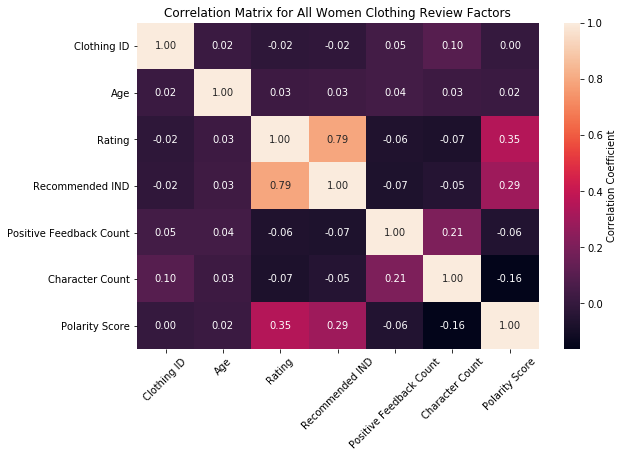

In [13]:
#Correlation Matrix for All Women Clothing Review Factors
plt.figure(figsize=[9,6])
_ = sns.heatmap(df.corr(), annot=True, fmt=".2f",cbar_kws={'label': 'Correlation Coefficient'})
plt.title("Correlation Matrix for All Women Clothing Review Factors")
plt.xticks(rotation=45)
plt.show()

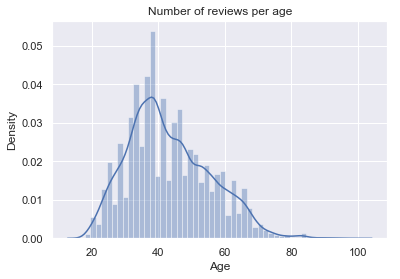

In [14]:
# overall age distribution
sns.set()
sns.distplot(df.Age)
plt.xlabel('Age')
plt.ylabel('Density')
plt.title('Number of reviews per age')
plt.show()

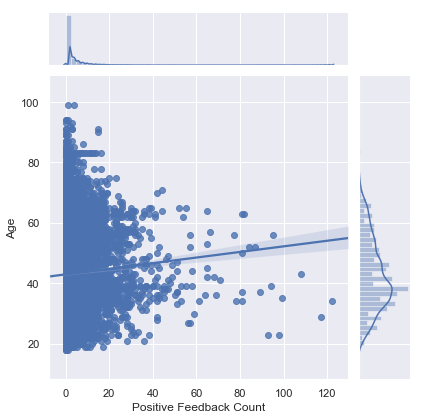

In [15]:
# the relationship between Positive Feedback vs Age
sns.jointplot(df['Positive Feedback Count'],df.Age,kind='reg')
plt.show()

In [16]:
# the total number of clothing ID 
print('the total number of Clothing ID in this dataset is: '+str(len(df['Clothing ID'].value_counts())))

the total number of Clothing ID in this dataset is: 1206


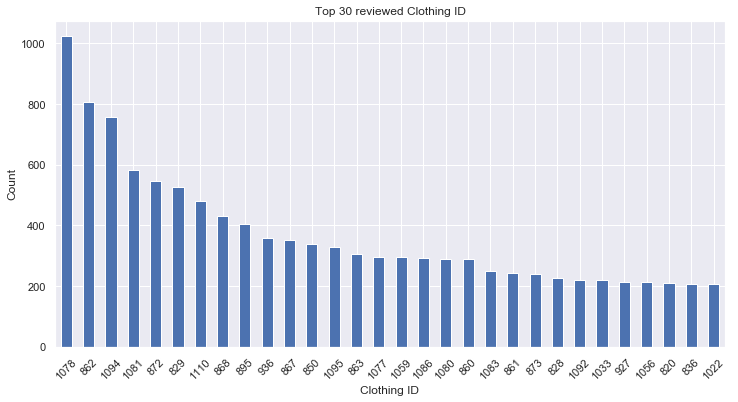

In [17]:
# the top 30 clothing ID
plt.figure(figsize=(12, 6))
df['Clothing ID'].value_counts()[:30].plot(kind='bar')
plt.xticks(rotation=45)
plt.xlabel('Clothing ID')
plt.ylabel('Count')
plt.title('Top 30 reviewed Clothing ID')
plt.show()

In [18]:
# find what is the most popular reivewing items
df1=df[df['Clothing ID'].isin([1078,863,1094])]['Class Name'].unique()
print('the most popular riewing items are : '+ str(df1))

the most popular riewing items are : ['Dresses' 'Knits']


In [19]:
# overal infro of the top reivewing items
df[df['Clothing ID'].isin([1078, 862,1094])].describe().drop('count',axis=0).drop('Clothing ID',axis =1)

,Age,Rating,Recommended IND,Positive Feedback Count,Character Count,Polarity Score
mean,42.631090,4.198763,0.820959,2.767208,300.522428,0.247592
std,12.110996,1.099646,0.383461,6.679159,152.930079,0.181306
min,18.000000,1.000000,0.000000,0.000000,0.000000,-0.500000
25%,34.000000,4.000000,1.000000,0.000000,176.000000,0.136553
50%,41.000000,5.000000,1.000000,1.000000,297.000000,0.241461
75%,50.000000,5.000000,1.000000,3.000000,457.000000,0.352133
max,99.000000,5.000000,1.000000,98.000000,504.000000,1.000000


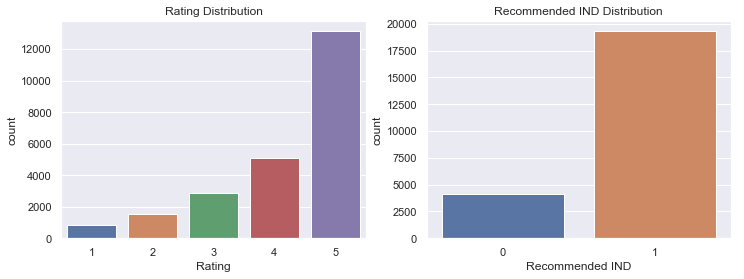

In [20]:
# overall Rating and Recommended IND distribution
plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
sns.countplot(df.Rating)
plt.title('Rating Distribution')
plt.subplot(1,2,2)
sns.countplot(df['Recommended IND'])
plt.title('Recommended IND Distribution')
plt.show()

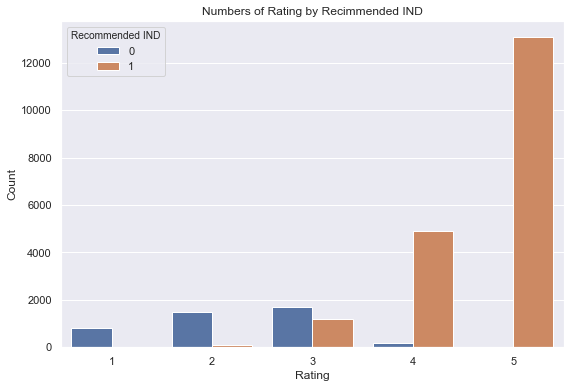

In [21]:
# Numbers of Rating by Recimmended IND
plt.figure(figsize=[9,6])
sns.countplot(x="Rating", hue="Recommended IND",data=df)
plt.title('Numbers of Rating by Recimmended IND')
plt.ylabel("Count")
plt.show()

In [22]:
# The Not recommend Portion
dislike = df['Recommended IND'].value_counts()[0]/(df['Recommended IND'].value_counts()[0]+df['Recommended IND'].value_counts()[1])
print('The Not recommend Portion in this datset is : '+str(dislike))

The Not recommend Portion in this datset is : 0.17763774163331347


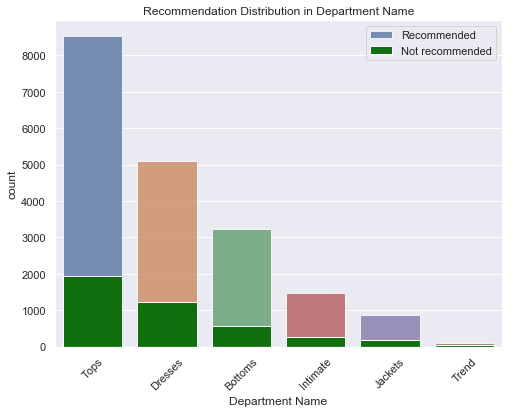

In [23]:
plt.figure(figsize = ((8,6)))
recommended = df[df['Recommended IND'] ==1]
not_recommended = df[df['Recommended IND']==0]
sns.countplot(recommended['Department Name'], order=df["Department Name"].value_counts().index,alpha=0.8, label = 'Recommended')
sns.countplot(not_recommended['Department Name'],order = df["Department Name"].value_counts().index,color= 'green',label='Not recommended')
plt.xticks(rotation=45)
plt.legend(loc= 'upper right')
plt.title('Recommendation Distribution in Department Name')
plt.show()

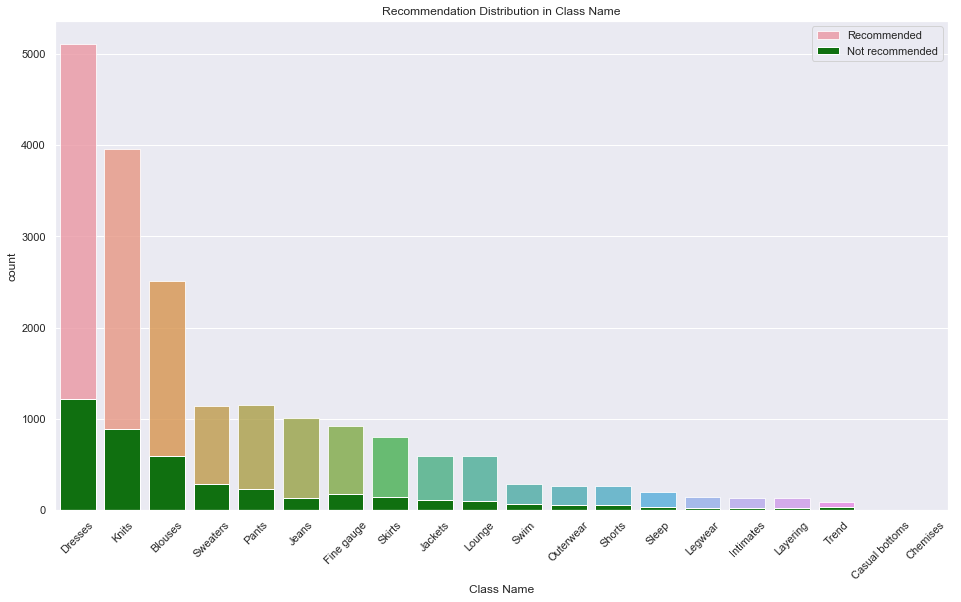

In [24]:
plt.figure(figsize = ((16,9)))
sns.countplot(recommended['Class Name'], order=df["Class Name"].value_counts().index,alpha=0.8, label = 'Recommended')
sns.countplot(not_recommended['Class Name'],order = df["Class Name"].value_counts().index,color= 'green',label='Not recommended')
plt.xticks(rotation=45)
plt.legend(loc= 'upper right')
plt.title('Recommendation Distribution in Class Name')
plt.show()

In [25]:
# reviw length in rating
rating = df.groupby(['Rating'])['Character Count'].count()
rating

Rating
1      842
2     1565
3     2871
4     5077
5    13131
Name: Character Count, dtype: int64

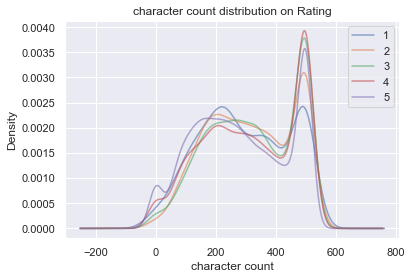

In [26]:
# review length distribution on Rating
df.groupby('Rating')['Character Count'].plot(kind = 'density',alpha=0.6)
plt.legend()
plt.xlabel('character count')
plt.title('character count distribution on Rating')
plt.show()

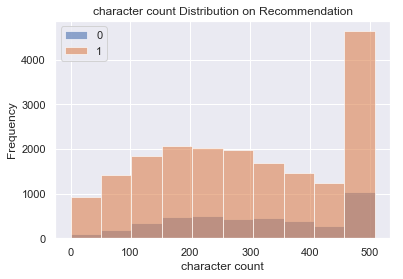

In [27]:
# review length distribution on Recommendation
df.groupby('Recommended IND')['Character Count'].plot(kind = 'hist',alpha = 0.6)
plt.legend()
plt.xlabel('character count')
plt.title('character count Distribution on Recommendation')
plt.show()

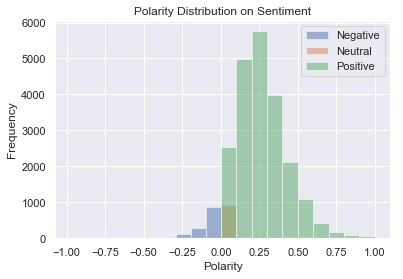

In [28]:
# sentiment analysis
df.groupby('Sentiment')['Polarity Score'].plot(kind = 'hist',alpha=0.5)
plt.legend()
plt.title('Polarity Distribution on Sentiment')
plt.xlabel('Polarity')
plt.show()

In [29]:

df['Filtered Review'] = df['Filtered Review'].apply(lambda x: ' '.join(x))

In [30]:
# initialize the vectorizer
count = CountVectorizer(stop_words='english',min_df=0.005,ngram_range=(1,2))
count.fit(df['Filtered Review'])
len(count.vocabulary_)

826

In [31]:
#transform the document into a bag of words
bag_of_words = count.transform(df['Filtered Review'])

In [32]:
# check the top 20 most common terms
occ = np.asarray(bag_of_words.sum(axis=0)).ravel().tolist()
counts_df = pd.DataFrame({'term': count.get_feature_names(), 'occurrences': occ})
count_top_20 = counts_df.sort_values(by='occurrences', ascending=False).head(20)

In [33]:
count_top_20.columns

Index(['term', 'occurrences'], dtype='object')

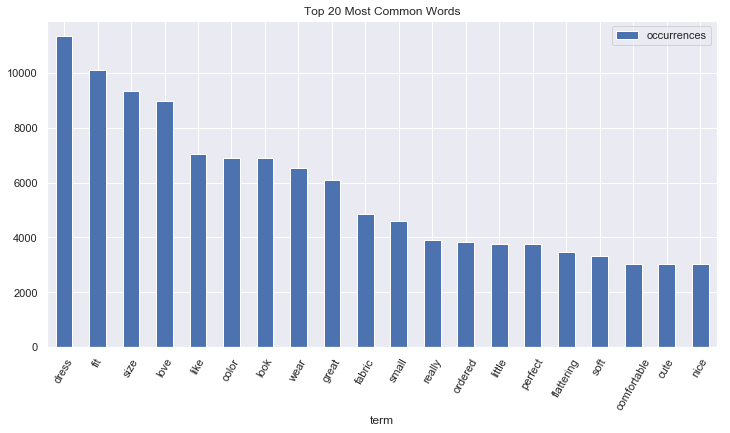

In [34]:
# plot the top 20 most common terms
fig, axes= plt.subplots(nrows=1, ncols=1,figsize=(12,6))
count_top_20.plot(ax=axes,kind='bar',x='term')
plt.xticks(rotation=60)
plt.title('Top 20 Most Common Words')
plt.show()

In [35]:
# use the TfidfTransformer to calculate the weights for each term
transformer = TfidfTransformer()
transformed_weights = transformer.fit_transform(bag_of_words)

In [36]:
# check the top 20 most common terms by average ti-idf weight
weights = np.asarray(transformed_weights.mean(axis=0)).ravel().tolist()
weights_df = pd.DataFrame({'term': count.get_feature_names(), 'weight': weights})
weight_top_20= weights_df.sort_values(by='weight', ascending=False).head(20)

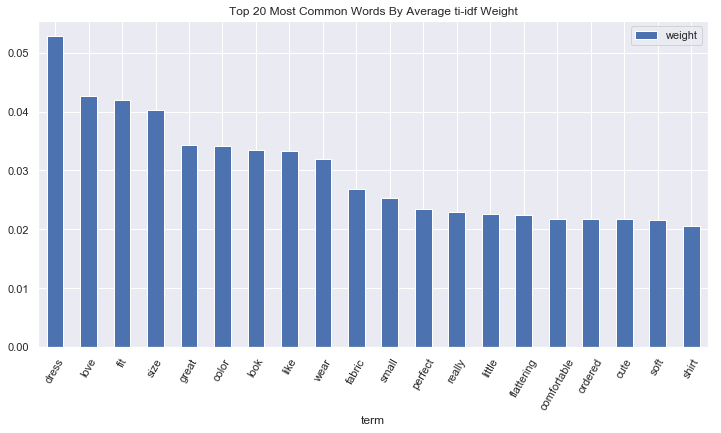

In [37]:
# plot the top 20 most common terms by average ti-idf weight
fig, axes= plt.subplots(nrows=1, ncols=1,figsize=(12,6))
weight_top_20.plot(ax=axes,kind='bar',x='term')
plt.xticks(rotation=60)
plt.title('Top 20 Most Common Words By Average ti-idf Weight')
plt.show()

# Machine Learning

In [38]:
# setup X,y value
text= df['Review Text']
y = df['Recommended IND']

In [39]:
# train-test split the data and fit-transform the X value to ti-idf vectorizer
text_train, text_test, y_train, y_test = train_test_split(text, y, test_size=0.33, random_state=42)
vectorizer = TfidfVectorizer(stop_words='english',min_df=0.005,ngram_range=(1,2))
X_train = vectorizer.fit_transform(text_train)
X_test = vectorizer.transform(text_test)

## Naive Bayes

In [40]:
# GridSearch
naive_gird = {'alpha':[.1, 1, 5, 10, 50]}
classifier = MultinomialNB()
classifier=GridSearchCV(classifier, naive_gird,scoring = "accuracy",cv = 5)
classifier.fit(X_train, y_train)
print('best parameter:{}'.format(classifier.best_params_),'best score: {}'.format(classifier.best_score_))

best parameter:{'alpha': 0.1} best score: 0.8639339053066413


In [41]:
# fit the data with best model
classifier = MultinomialNB(alpha = 0.1)
classifier.fit(X_train, y_train)

MultinomialNB(alpha=0.1, class_prior=None, fit_prior=True)

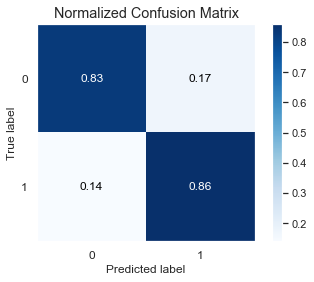

In [42]:
# confusion_matrix
skplt.metrics.plot_confusion_matrix(classifier.predict(X_test), y_test, normalize=True)
plt.show()

In [43]:
# classification report
print(classification_report(classifier.predict(X_test), y_test))

              precision    recall  f1-score   support

           0       0.26      0.83      0.40       438
           1       0.99      0.86      0.92      7313

    accuracy                           0.86      7751
   macro avg       0.62      0.84      0.66      7751
weighted avg       0.95      0.86      0.89      7751



## Logistic Regression

In [44]:
# GirdSearch
logreg_gird = {'C':[.1, 1, 5, 10]}
logreg = LogisticRegression()
logreg = GridSearchCV(logreg, logreg_gird,scoring = "accuracy",cv = 5)
logreg.fit(X_train, y_train)
print('best parameter:{}'.format(logreg.best_params_),'best score:{}'.format(logreg.best_score_))

best parameter:{'C': 5} best score:0.8840165236733397


In [45]:
# fit the data with best model
logreg = LogisticRegression(C = 5)
logreg.fit(X_train, y_train)

LogisticRegression(C=5, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

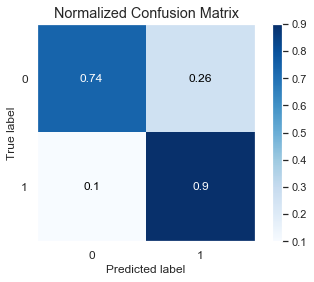

In [46]:
# Confusion Matrix
skplt.metrics.plot_confusion_matrix(logreg.predict(X_test), y_test, normalize=True)
plt.show()

In [47]:
# classification report
print(classification_report(logreg.predict(X_test), y_test))

              precision    recall  f1-score   support

           0       0.54      0.74      0.62      1006
           1       0.96      0.90      0.93      6745

    accuracy                           0.88      7751
   macro avg       0.75      0.82      0.78      7751
weighted avg       0.90      0.88      0.89      7751



## Random Froest

In [48]:
#GirdSearch
random_gird={'max_depth':[10,30,50,70],
             'min_samples_leaf':[1,2,4,6],
              'max_features':['auto','sqrt']}
model_rf = RandomForestClassifier()
model_rf = GridSearchCV(model_rf, random_gird,scoring = "accuracy",cv = 5)

In [49]:
model_rf.fit(X_train, y_train)
print('best parameter:{}'.format(model_rf.best_params_),'best score:{}'.format(model_rf.best_score_))

best parameter:{'max_depth': 50, 'max_features': 'auto', 'min_samples_leaf': 1} best score:0.8597394343819511


In [50]:
# # fit the data with best model
model_rf = RandomForestClassifier(max_depth=50,max_features='auto',n_estimators=500)
model_rf.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=50, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=500,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

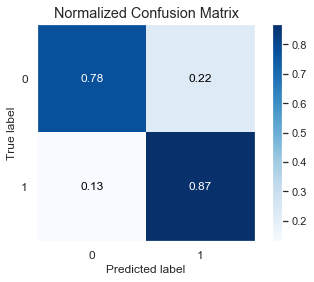

In [51]:
# Confusion Matrix
skplt.metrics.plot_confusion_matrix(model_rf.predict(X_test), y_test, normalize=True)
plt.show()

In [52]:
# classification report
print(classification_report(model_rf.predict(X_test), y_test))

              precision    recall  f1-score   support

           0       0.31      0.78      0.45       563
           1       0.98      0.87      0.92      7188

    accuracy                           0.86      7751
   macro avg       0.65      0.82      0.68      7751
weighted avg       0.93      0.86      0.89      7751



# SHAP

In [53]:
# load JS visualization code to notebook
shap.initjs()

In [54]:
# explain the model's predictions using SHAP values
explainer = shap.LinearExplainer(logreg,X_train,feature_dependence="independent")
shap_values = explainer.shap_values(X_test)

In [55]:
# put all the features in a dataframe
new_df = pd.DataFrame(X_test.toarray(),columns = vectorizer.get_feature_names())

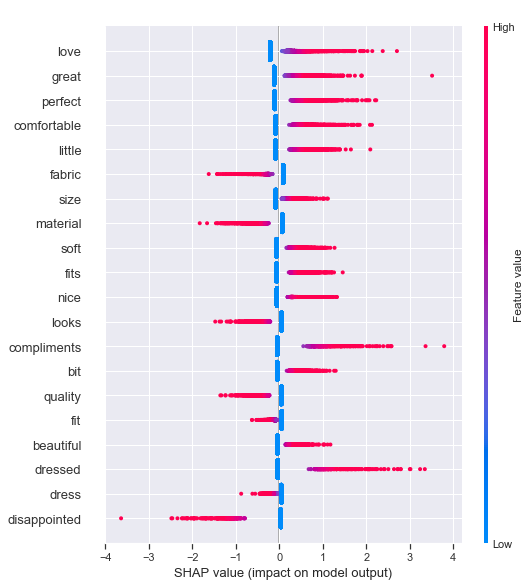

In [56]:
# summarize the effects of all the features
shap.summary_plot(shap_values,new_df)

# LIME

In [57]:
# make a pipeline for vectorizer and logistic regression classifier
pipeline = make_pipeline(vectorizer,logreg)

In [58]:
# explain the model's predictions using LIME values
lime_explainer = LimeTextExplainer(bow=False,class_names=[0,1])
for idx in(14,41,56,58,61,67,78,103,107,121,125,141,142,148):
    exp = lime_explainer.explain_instance(text_test.iloc[idx], pipeline.predict_proba, num_features=8)
    print('True class: %s' % y_test.iloc[idx])
    exp.show_in_notebook(text=True)

True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0


True class: 0
